In [2]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import cartopy
import matplotlib
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.gridliner import LONGITUDE_FORMATTER, LATITUDE_FORMATTER
import cartopy.mpl.ticker
import numpy as np
import importlib
import xarray as xr
import nc_time_axis
import cmocean
import cmocean.cm as cmo
from matplotlib.colors import ListedColormap
import seaborn as sns
import matplotlib.patches as mpatches
from matplotlib.patches import Patch, Polygon
import matplotlib.ticker as mticker
from mpl_toolkits.axes_grid1.inset_locator import inset_axes, BboxPatch, BboxConnector,\
    BboxConnectorPatch, zoomed_inset_axes, mark_inset
from matplotlib.transforms import (
    Bbox, TransformedBbox, blended_transform_factory)
from mpl_toolkits.axes_grid1.anchored_artists import AnchoredSizeBar
import shapely.geometry as sgeom
from matplotlib.lines import Line2D as Line
from matplotlib.patheffects import Stroke
import mpl_toolkits.axes_grid1.inset_locator as il
import cv2
import glob
import nc_time_axis
from eofs.xarray import Eof
import scipy.signal as sps
import scipy.linalg as spl
from scipy import stats
from matplotlib import gridspec
from scipy.signal import butter, lfilter
from functools import partial
from matplotlib.lines import Line2D

from statsmodels.tsa.seasonal import STL
import pandas as pd
from scipy.integrate import odeint
import _pickle as cPickle
import os,sys
from matplotlib.font_manager import FontProperties
import string
import matplotlib.patches as patches
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib.colors import LinearSegmentedColormap

import ultraplot as pplt

from matplotlib import patheffects

In [3]:
mpl.rcParams['figure.dpi'] = 100

In [4]:
import warnings
warnings.filterwarnings("ignore", category=RuntimeWarning) 

In [5]:
from shapely.errors import ShapelyDeprecationWarning
warnings.filterwarnings("ignore", category=ShapelyDeprecationWarning) 

In [6]:
def anom(ds):
    
    ds_clim = ds.groupby('time.month').mean(dim='time')
    ds_anom = ds.groupby('time.month') - ds_clim
    
    return ds_anom

def NINO34_idx(sst,time='time'):
    
    if sst.lat.values[0] < 0:
        sst = sst.sel(lat=slice(-6,6),lon=slice(360-170,360-120))
    else:
        sst = sst.sel(lat=slice(6,-6),lon=slice(360-170,360-120))
        
    nino34 = sst.mean(dim=('lat','lon'))
    
    return anom(nino34)

def NINO34(sst,model=None,time='time'):
    
    if sst.lat.values[0] < 0:
        sst = sst.sel(lat=slice(-6,6),lon=slice(360-170,360-120))
    else:
        sst = sst.sel(lat=slice(6,-6),lon=slice(360-170,360-120))

    return sst.mean(dim=('lat','lon'))


def EIO(sst,model=None,time='time'):
    
    if sst.lat.values[0] < 0:
        sst_EIO = sst.sel(lat=slice(-11,0),lon=slice(90,110))
    else:
        sst_EIO = sst.sel(lat=slice(0,-11),lon=slice(90,110))

    return sst_EIO.mean(dim=('lat','lon'))


def WIO(sst,model=None,time='time'):
    
    if sst.lat.values[0] < 0:
        sst_WIO = sst.sel(lat=slice(-11,11),lon=slice(50,70))
    else:
        sst_WIO = sst.sel(lat=slice(11,-11),lon=slice(50,70))

    return sst_WIO.mean(dim=('lat','lon'))

def DMI(sst,model=None,time='time'):
    
    sst_DMI = WIO(sst) - EIO(sst)
    
    return sst_DMI

def DMI_idx(ds):
    return anom(WIO(ds)) - anom(EIO(ds))

In [7]:
#year, orb_year, eccentricity, obliquity, longitude of perihelion, and precession index (6th column)
# 2 Ma [74880:]

df = pd.read_csv("variables/pCESM.2Ma_orbPara.txt", sep="\s+", header=None)

ds_orb = df.to_xarray().rename({'index':'time'})#.isel(time=slice(None, None, -1))
ds_orb['time'] = ds_orb[0]



In [7]:
df_co2 = pd.read_csv("variables/Insol_GHG_d18o_0ka_2000.txt", sep="\s+", header=None)
ds_co2 = df_co2.to_xarray().rename({'index':'time'}).isel(time=slice(None, None, -1))
ds_co2['time'] = -ds_co2['time'] 


In [8]:
co2 = ds_co2.interp(time=ds_orb['time'])[2]
co2_ = co2.rename({'time':'year'})
co2_ = co2_.interp(year=-np.arange(0,4800012,1)[::-1]/12*5/1000)

In [9]:
sle = ds_co2.interp(time=ds_orb['time'])[7]
sle_ = sle.rename({'time':'year'})
sle_ = sle_.interp(year=-np.arange(0,4800012,1)[::-1]/12*5/1000)

In [8]:
params_ = xr.open_dataset('variables/pCESM.2Ma_orbPara.nc')
params = params_.interp(year=-np.arange(0,4800012,1)[::-1]/12*5/1000)

In [11]:
temp_adj = xr.open_dataset('variables/adjusted/TS.full.2Ma.mon.masked_monlenadj_hm.nc',decode_times=False)['TS']

In [12]:
mask = xr.open_dataset('variables/pCESM.2Ma_SSH.100yr.nc',decode_times=False).SSH
mask = mask.sel(lon=slice(temp_adj.lon.min().values,temp_adj.lon.max().values),
               lat=slice(temp_adj.lat.min().values,temp_adj.lat.max().values))

In [13]:
mask_ocean = 2 * np.ones((len(mask.coords['lat']), len(mask.coords['lon']))) * np.isfinite(mask[0])  
mask_land = 1 * np.ones((len(mask.coords['lat']), len(mask.coords['lon']))) * np.isnan(mask[0])  
mask_array = mask_ocean + mask_land

In [14]:
!ls variables/*adj*

variables/cors_temp_dmi_adj.nc
variables/cors_temp_nino34_adj.nc
variables/eio_adj.nc
variables/nino34_adj.nc
variables/nino3_adj.nc
variables/nino4_adj.nc
variables/shf.full.2Ma.mon_monlenadj_hm.nc
variables/slopes_temp_dmi_adj.nc
variables/slopes_temp_nino34_adj.nc
variables/trop_indian_all_adj.nc
variables/trop_indian_south_adj.nc
variables/trop_pacific_adj.nc
variables/wio_adj.nc

variables/adjusted:
TS.full.2Ma.mon.masked_monlenadj_hm.nc
imonth_lengths_2Ma_ann_palinsol_ber78.csv
prect.full.2Ma.mon_monlenadj_hm.nc
rmonth_lengths_2Ma_ann_palinsol_ber78.csv
solin.full.2Ma.mon_monlenadj_hm.nc
taux.full.2Ma.mon_monlenadj_hm.nc
tauy.full.2Ma.mon_monlenadj_hm.nc
thermocline.full.2Ma.mon_monlenadj_hm.nc


In [9]:
nino4 = xr.open_dataset('variables/nino4_adj.nc', decode_times=False).TS
nino3 = xr.open_dataset('variables/nino3_adj.nc', decode_times=False).TS
eio =  xr.open_dataset('variables/eio_adj.nc', decode_times=False).TS
nino34 = xr.open_dataset('variables/nino34_adj.nc', decode_times=False).TS
wio = xr.open_dataset('variables/wio_adj.nc', decode_times=False).TS
dmi = wio - eio

In [16]:
cobe = xr.open_dataset('variables/sst_cobe.nc').sst
cobe = cobe.sel(time=slice('1950-01-01','2019-12-01'))

In [17]:
cobe_nino34 = cobe.sel(lat=slice(5,-5),lon=slice(360-170,360-120)).mean(dim=('lat','lon')).groupby('time.year').mean()#.std()#.rolling(year=10).std().mean()
cobe_eio = cobe.sel(lat=slice(0,-10),lon=slice(90,110)).mean(dim=('lat','lon')).groupby('time.year').mean()#.std()#.rolling(year=10).std().mean()
cobe_wio = cobe.sel(lat=slice(10,-10),lon=slice(50,70)).mean(dim=('lat','lon')).groupby('time.year').mean()#.std()#.rolling(year=10).std().mean()
cobe_dmi = (cobe.sel(lat=slice(10,-10),lon=slice(50,70)).mean(dim=('lat','lon')).groupby('time.year').mean() - cobe.sel(lat=slice(0,-10),lon=slice(90,110)).mean(dim=('lat','lon')).groupby('time.year').mean())#.std()

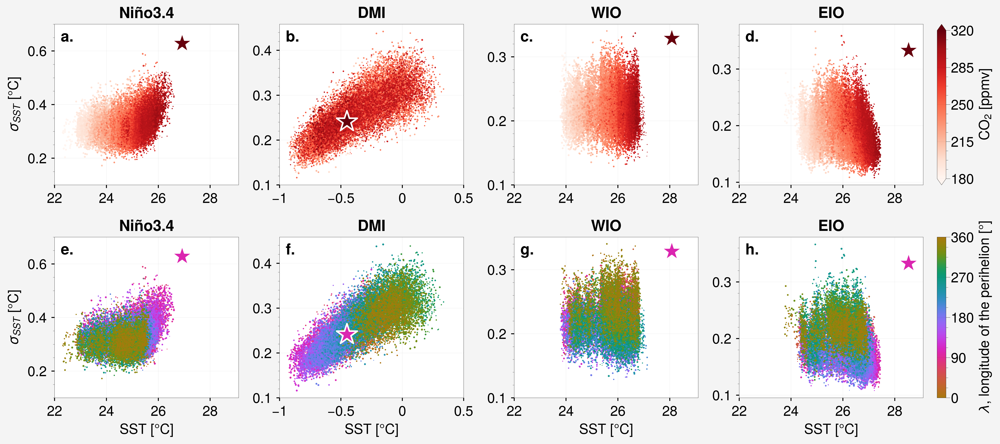

In [22]:

fig, axs = pplt.subplots(nrows=2, ncols=4, figsize=(45, 20), share=False)
pplt.rc['font.size'] = 45
base_fontsize = pplt.rc['font.size']

datasets = [nino34, dmi, wio, eio]
names = ['nino34', 'dmi', 'wio', 'eio']
char_labels = {'nino34': 'Niño3.4', 'dmi': 'DMI', 'wio': 'WIO', 'eio': 'EIO'}

for i, (ds, name, ax) in enumerate(zip(datasets * 2, names * 2, axs)):
    # Select reference dataset statistics
    cobe_var, cobe_mean = {
        'nino34': (cobe_nino34.std(), cobe_nino34.mean()),
        'dmi': (cobe_dmi.std(), cobe_dmi.mean()),
        'wio': (cobe_wio.std(), cobe_wio.mean()),
        'eio': (cobe_eio.std(), cobe_eio.mean())
    }[name]

    # Convert temperature if not 'dmi'
    ds = ds if name == 'dmi' else ds - 273.15

    # Scatter plot parameters

    vmax, vmin, cmap, exp = (320, 180, 'Reds', 1) if i < 4 else (360, 0, 'Phase', 10000)
    idx_co2 = co2.argsort() if i < 4 else df[4].to_xarray().rename({'index': 'time'}).argsort()
    color_data = co2.values[idx_co2] if i < 4 else df[4].values[idx_co2]
    size_data = co2.values * exp if i < 4 else df[2].values * exp

    # Plot
    if cmap == 'Phase':
        im = ax.scatter(ds.rolling(year=50, center=True).mean()[::20][idx_co2],
                    ds.rolling(year=50, center=True).std()[::20][idx_co2],
                    c=color_data, alpha=1, s=size_data, vmin=vmin, vmax=vmax, cmap=cmap)
    else:
        im2 = ax.scatter(ds.rolling(year=50, center=True).mean()[::20][idx_co2],
                    ds.rolling(year=50, center=True).std()[::20][idx_co2],
                    c=color_data, alpha=1, s=size_data, vmin=vmin, vmax=vmax, cmap=cmap)
    
    ax.scatter(cobe_mean, cobe_var, c=[380 if i < 4 else 103], vmin=vmin, vmax=vmax,
               s=5000, cmap=cmap, marker='*', linewidths=5, edgecolors='w')
    
    # Labels and ticks
    ax.set_title(char_labels[name], y=1.1, fontweight='bold')
    ax.tick_params(width=3, pad=15, length=15)
    
    if i >= 4:
        ax.set_xlabel("SST [°C]", labelpad=15)
    else:
        ax.set_xlabel("")

    if i == 0 or i == 4:
        ax.set_ylabel(r"$\sigma_{SST}$ [°C]", labelpad=20)
    else:
        ax.set_ylabel("")
    
    if name == 'nino34':
        ax.set(yticks=[0.2, 0.4, 0.6], xticks=[22, 24, 26, 28], xlim=(22, 29.1), ylim=(0.1, 0.7))
    elif name in ['wio', 'eio']:
        ax.set(yticks=[0.1, 0.2, 0.3], xticks=[22, 24, 26, 28], xlim=(22, 29.1))
    elif name == 'dmi':
        ax.set(yticks=[0.1, 0.2, 0.3, 0.4], xticks=[-1, -0.5, 0, 0.5], xlim=(-1, 0.5))

args = {'ticklen' : 13.5, 'width' : .4, 
'align' : 'center', 'space' : 1, 'extendsize':0.45}

# Colorbars
cb1 = axs[3].colorbar(im2, loc='r', label=r"CO$_{2}$ [ppmv]", 
             ticks=[180, 215, 250, 285, 320], extend='both', **args)
cb1.set_label(r"CO$_{2}$ [ppmv]", labelpad=15, fontsize=base_fontsize)
cb1.ax.tick_params(labelsize=base_fontsize)

cb2 = axs[7].colorbar(im, loc='r', label=r"$\lambda$, longitude of the perihelion [°]",
             ticks=np.arange(0, 360 + 90, 90), **args)

cb2.set_label(r"$\lambda$, longitude of the perihelion [°]", labelpad=15, fontsize=base_fontsize)
cb2.ax.tick_params(labelsize=base_fontsize)


axs.format(abc='a.',abcloc='ul', titleloc='c', titlepad=20,abctitlepad=10, 
xtickdir='out', ytickdir='out', xtickminor=False, ygridminor=False, ticklen=10)

fig.savefig("config_mean_var/co2_lon.png", dpi=300, bbox_inches='tight', transparent=True)

In [162]:
fig, axs = pplt.subplots(nrows=4, ncols=6, share=False, axwidth=8, axheight=5.5)
pplt.rc['font.size'] = 45

ax1 = axs[0] ; ax2 = axs[1] ; ax3 = axs[2] ; ax4 = axs[3] ; ax5 = axs[4] ; ax6 = axs[5] 
ax7 = axs[6] ; ax8 = axs[7] ; ax9 = axs[8] ; ax10 = axs[9] ; ax11 = axs[10] ; ax12 = axs[11] 
ax13 = axs[12] ; ax14 = axs[13] ; ax15 = axs[14] ; ax16 = axs[15] ; ax17 = axs[16] ; ax18 = axs[17]
ax19 = axs[18] ; ax20 = axs[19] ; ax21 = axs[20] ; ax22 = axs[21] ; ax23 = axs[22] ; ax24 = axs[23]

s = 10 * 2

for ds, name, ax in zip([nino34, dmi, wio, eio], ['nino34', 'dmi', 'wio', 'eio'],
                       [ [ax1,ax2,ax3,ax4,ax5,ax6], 
                        [ax7,ax8,ax9,ax10,ax11,ax12],
                        [ax13,ax14,ax15,ax16,ax17,ax18],
                        [ax19,ax20,ax21,ax22,ax23,ax24]]):
        
    if (ds.values[0] == wio.values[0]):
        cobe = cobe_wio.mean()
    elif (ds.values[0] == dmi.values[0]):
        cobe = cobe_dmi.mean() 
    elif (ds.values[0] == eio.values[0]):
        cobe = cobe_eio.mean()
    elif (ds.values[0] == nino34.values[0]):
        cobe = cobe_nino34.mean()
        
    print(cobe.values)
    
    if name == 'nino34':
        char = 'Niño3.4'
        ylabel = 'Niño3.4 SST [°C]'
        
    elif name == 'dmi':
        char = 'DMI'
        ylabel = 'WIO $-$ EIO SST [°C]'
        
    elif name == 'wio':
        char = 'WIO'
        ylabel = 'WIO SST [°C]'
        
    elif name == 'eio':
        char = 'EIO'
        ylabel = 'EIO SST [°C]'
    
    if name == 'dmi':
        ds = ds
        kwargs = {'ylim': (-1,.5), 'ylocator':[-1,-.5,0,.5]}
    else:
        ds = ds -273.15
        kwargs = {'ylim': (22,29), 'ylocator':[22,24,26,28]}


    ax[0].scatter(df[2], ds.rolling(year=50,center=True).mean()[::20], c='r', alpha=1, s=s)
    ax[0].axvline(0.0167, linestyle='-', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[0].format(xlabel= r"$e$, eccentricity", xlim = (0, 0.055), ylabel=ylabel, **kwargs)
    ax[0].axhline(0, linestyle='--', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    #ax[0].scatter(0.0167,cobe,c='r',alpha=1,s=10000/2,marker='*',linewidths=6, edgecolors='k', zorder=100)
    ax[0].scatter(0.0167,cobe,c='r',alpha=1,s=1000*3.5,marker='*',linewidths=6, edgecolors='w',zorder=100)

    ax[1].scatter(df[3], ds.rolling(year=50,center=True).mean()[::20], c='cornflowerblue', alpha=1, s=s)
    ax[1].axvline(23.46, linestyle='-', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[1].format(xlabel="obliquity [°]", xlim= (22, 24.5), ylabel=ylabel, **kwargs)
    ax[1].axhline(0, linestyle='--', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[1].scatter(23.46,cobe,c='cornflowerblue',alpha=1,s=1000*3.5,marker='*',linewidths=6, edgecolors='w',zorder=100)

    ax[2].scatter(df[4], ds.rolling(year=50,center=True).mean()[::20], c='g', alpha=1, s=s)
    ax[2].format(xlabel=r"$\lambda$, longitude of" + "\n the perihelion [°]", xlim=(0, 360),
                xlocator=np.arange(0, 360 + 90, 90), ylabel=ylabel, **kwargs)
    ax[2].axvline(abs(280.3 - 180), linestyle='-', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[2].axhline(0, linestyle='--', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[2].scatter(abs(280.3 - 180),cobe,c='g',alpha=1,s=1000*3.5,marker='*',linewidths=6, edgecolors='w',zorder=100)

    ax[3].scatter(df[5], ds.rolling(year=50,center=True).mean()[::20], c='firebrick', alpha=1, s=s)
    ax[3].axvline(0.0167 * np.sin( np.radians(abs(280.3 - 180)) ), linestyle='-', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[3].format(xlim=([-0.05,0.05]), xlocator=[-0.05, -.025, 0, 0.025, 0.05], 
                xlabel=r"e$\times$sin($\lambda$)" + "\n precession parameter", ylabel=ylabel, **kwargs)
    ax[3].axhline(0, linestyle='--', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[3].axvline(0, linestyle='--', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[3].scatter(0.0167 * np.sin( np.radians(abs(280.3 - 180)) ),cobe,c='firebrick',alpha=1,s=1000*3.5,marker='*',linewidths=6, edgecolors='w',zorder=100)

    ax[4].scatter(co2, ds.rolling(year=50,center=True).mean()[::20], c='orange', alpha=1, s=s)
    ax[4].axvline(300, linestyle='-', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[4].format(xlim=(180,310), xlabel=r"CO$_2$ [ppmv]", ylabel=ylabel, **kwargs )
    ax[4].axhline(0, linestyle='--', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[4].scatter(300,cobe,c='orange',alpha=1,s=1000*3.5,marker='*',linewidths=6, edgecolors='w',zorder=100)

    ax[5].scatter(sle, ds.rolling(year=50,center=True).mean()[::20], c='k', alpha=1, s=s)
    ax[5].axvline(0, linestyle='-', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[5].format(xlim=(-150,10), xlabel="ice volume in \n sea level equivalent [m]", ylabel=ylabel, **kwargs)
    ax[5].axhline(0, linestyle='--', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[5].scatter(0,cobe,c='k',alpha=1,s=1000*3.5,marker='*',linewidths=6, edgecolors='w',zorder=100)
            
axs.format(abc='a.',abcloc='ul', titleloc='c', 
xtickdir='out', ytickdir='out', xtickminor=False, ygridminor=False, ticklen=18.5, 
ylabelpad=15, xlabelpad=15)

plt.savefig(f"config_mean/config.png", dpi=300, format='png',
    bbox_inches='tight', #pad_inches=.3,
    transparent=True
   )


26.917704
-0.4518029
28.080027
28.53183


In [166]:
fig, axs = pplt.subplots(nrows=4, ncols=6, share=False, axwidth=8, axheight=5.5)
pplt.rc['font.size'] = 45

ax1 = axs[0] ; ax2 = axs[1] ; ax3 = axs[2] ; ax4 = axs[3] ; ax5 = axs[4] ; ax6 = axs[5] 
ax7 = axs[6] ; ax8 = axs[7] ; ax9 = axs[8] ; ax10 = axs[9] ; ax11 = axs[10] ; ax12 = axs[11] 
ax13 = axs[12] ; ax14 = axs[13] ; ax15 = axs[14] ; ax16 = axs[15] ; ax17 = axs[16] ; ax18 = axs[17]
ax19 = axs[18] ; ax20 = axs[19] ; ax21 = axs[20] ; ax22 = axs[21] ; ax23 = axs[22] ; ax24 = axs[23]

s = 10 * 2

for ds, name, ax in zip([nino34, dmi, wio, eio], ['nino34', 'dmi', 'wio', 'eio'],
                       [ [ax1,ax2,ax3,ax4,ax5,ax6], 
                        [ax7,ax8,ax9,ax10,ax11,ax12],
                        [ax13,ax14,ax15,ax16,ax17,ax18],
                        [ax19,ax20,ax21,ax22,ax23,ax24]]):
        
    if ds.values[0] == wio.values[0]:
        cobe = cobe_wio.std()
    elif (ds.values[0] == dmi.values[0]):
        cobe = cobe_dmi.std() 
    elif (ds.values[0] == eio.values[0]):
        cobe = cobe_eio.std()
    elif (ds.values[0] == nino34.values[0]):
        cobe = cobe_nino34.std()
        
    print(cobe.values)
    
    if name == 'nino34':
        char = 'Niño3.4'
        ylabel = 'Niño3.4 $\sigma_{SST}$ [°C]'

        kwargs = {'ylim': (0.1,0.65), 'ylocator':[0.2,0.4,0.6]}
        
    elif name == 'dmi':
        char = 'DMI'
        ylabel = 'DMI $\sigma_{SST}$ [°C]'

        kwargs = {'ylim': (0.1,0.45), 'ylocator':[0.1,0.2,0.3,0.4]}
        
    elif name == 'wio':
        char = 'WIO'
        ylabel = 'WIO $\sigma_{SST}$ [°C]'

        kwargs = {'ylim': (0.1,0.35), 'ylocator':[0.1,0.2,0.3]}
        
    elif name == 'eio':
        char = 'EIO'
        ylabel = 'EIO $\sigma_{SST}$ [°C]'

        kwargs = {'ylim': (0.1,0.35), 'ylocator':[0.1,0.2,0.3]}

    ax[0].scatter(df[2], ds.rolling(year=50,center=True).std()[::20], c='r', alpha=1, s=s)
    ax[0].axvline(0.0167, linestyle='-', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[0].format(xlabel= r"$e$, eccentricity", xlim = (0, 0.055), ylabel=ylabel, **kwargs)
    ax[0].axhline(0, linestyle='--', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    #ax[0].scatter(0.0167,cobe,c='r',alpha=1,s=10000/2,marker='*',linewidths=6, edgecolors='k', zorder=100)
    ax[0].scatter(0.0167,cobe,c='r',alpha=1,s=1000*3.5,marker='*',linewidths=6, edgecolors='w',zorder=100)

    ax[1].scatter(df[3], ds.rolling(year=50,center=True).std()[::20], c='cornflowerblue', alpha=1, s=s)
    ax[1].axvline(23.46, linestyle='-', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[1].format(xlabel="obliquity [°]", xlim= (22, 24.5), ylabel=ylabel, **kwargs)
    ax[1].axhline(0, linestyle='--', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[1].scatter(23.46,cobe,c='cornflowerblue',alpha=1,s=1000*3.5,marker='*',linewidths=6, edgecolors='w',zorder=100)

    ax[2].scatter(df[4], ds.rolling(year=50,center=True).std()[::20], c='g', alpha=1, s=s)
    ax[2].format(xlabel=r"$\lambda$, longitude of" + "\n the perihelion [°]", xlim=(0, 360),
                xlocator=np.arange(0, 360 + 90, 90), ylabel=ylabel, **kwargs)
    ax[2].axvline(abs(280.3 - 180), linestyle='-', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[2].axhline(0, linestyle='--', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[2].scatter(abs(280.3 - 180),cobe,c='g',alpha=1,s=1000*3.5,marker='*',linewidths=6, edgecolors='w',zorder=100)

    ax[3].scatter(df[5], ds.rolling(year=50,center=True).std()[::20], c='firebrick', alpha=1, s=s)
    ax[3].axvline(0.0167 * np.sin( np.radians(abs(280.3 - 180)) ), linestyle='-', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[3].format(xlim=([-0.05,0.05]), xlocator=[-0.05, -.025, 0, 0.025, 0.05], 
                xlabel=r"e$\times$sin($\lambda$)" + "\n precession parameter", ylabel=ylabel, **kwargs)
    ax[3].axhline(0, linestyle='--', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[3].axvline(0, linestyle='--', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[3].scatter(0.0167 * np.sin( np.radians(abs(280.3 - 180)) ),cobe,c='firebrick',alpha=1,s=1000*3.5,marker='*',linewidths=6, edgecolors='w',zorder=100)

    ax[4].scatter(co2, ds.rolling(year=50,center=True).std()[::20], c='orange', alpha=1, s=s)
    ax[4].axvline(300, linestyle='-', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[4].format(xlim=(180,310), xlabel=r"CO$_2$ [ppmv]", ylabel=ylabel, **kwargs )
    ax[4].axhline(0, linestyle='--', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[4].scatter(300,cobe,c='orange',alpha=1,s=1000*3.5,marker='*',linewidths=6, edgecolors='w',zorder=100)

    ax[5].scatter(sle, ds.rolling(year=50,center=True).std()[::20], c='k', alpha=1, s=s)
    ax[5].axvline(0, linestyle='-', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[5].format(xlim=(-150,10), xlabel="ice volume in \n sea level equivalent [m]", ylabel=ylabel, **kwargs)
    ax[5].axhline(0, linestyle='--', color='dimgrey', alpha=1, zorder=10, linewidth=5,
    path_effects=[patheffects.withStroke(linewidth=10, foreground="w")])
    ax[5].scatter(0,cobe,c='k',alpha=1,s=1000*3.5,marker='*',linewidths=6, edgecolors='w',zorder=100)
            
axs.format(abc='a.',abcloc='ul', titleloc='c', 
xtickdir='out', ytickdir='out', xtickminor=False, ygridminor=False, ticklen=18.5, 
ylabelpad=15, xlabelpad=15)

plt.savefig(f"config/config.png", dpi=300, format='png',
    bbox_inches='tight', #pad_inches=.3,
    transparent=True
   )


0.6284176
0.24122539
0.32863748
0.3329006


In [378]:
import pickle

# Load datasets from pickles
loaded_datasets_nino34 = {}
loaded_datasets_dmi = {}

nino34_names = ['pc1_nino34', 'pc2_nino34', 'pc3_nino34', 'eof1_nino34', 'eof2_nino34', 'eof3_nino34', 'var_expl_nino34']
dmi_names = ['pc1_dmi', 'pc2_dmi', 'pc3_dmi', 'eof1_dmi', 'eof2_dmi', 'eof3_dmi', 'var_expl_dmi']

for name in nino34_names:
    with open(f'variables/{name}.pkl', 'rb') as f:
        loaded_datasets_nino34[name] = pickle.load(f)

for name in dmi_names:
    with open(f'variables/{name}.pkl', 'rb') as f:
        loaded_datasets_dmi[name] = pickle.load(f)

# Access the loaded datasets
pc1_nino34 = loaded_datasets_nino34['pc1_nino34']
pc2_nino34 = loaded_datasets_nino34['pc2_nino34']
pc3_nino34 = loaded_datasets_nino34['pc3_nino34']
eof1_nino34 = loaded_datasets_nino34['eof1_nino34']
eof2_nino34 = loaded_datasets_nino34['eof2_nino34']
eof3_nino34 = loaded_datasets_nino34['eof3_nino34']
var_expl_nino34 = loaded_datasets_nino34['var_expl_nino34']

pc1_dmi = loaded_datasets_dmi['pc1_dmi']
pc2_dmi = loaded_datasets_dmi['pc2_dmi']
pc3_dmi = loaded_datasets_dmi['pc3_dmi']
eof1_dmi = loaded_datasets_dmi['eof1_dmi']
eof2_dmi = loaded_datasets_dmi['eof2_dmi']
eof3_dmi = loaded_datasets_dmi['eof3_dmi']
var_expl_dmi = loaded_datasets_dmi['var_expl_dmi']

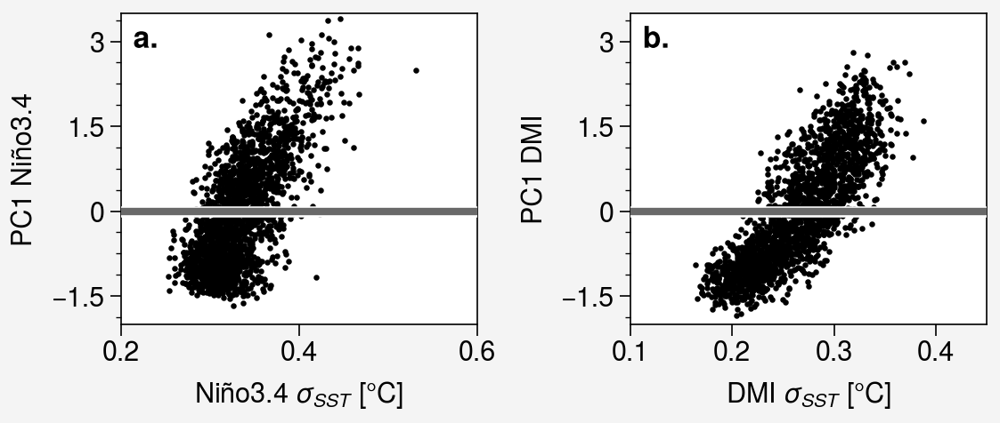

In [416]:
k = 0

array = [[ 1,  2]]
fig, axs = pplt.subplots(array, share=False, refheight=1.75, refwidth=2)

pplt.rc['font.size'] = 11

s = 3

axs[0].scatter(nino34.rolling(year=200, center=True).std()[::200][:-1], -pc1_nino34, c='k', alpha=1, s=s)
axs[0].axhline(0, linestyle='-', color='dimgrey', alpha=1, zorder=10, linewidth=3,
               path_effects=[patheffects.withStroke(linewidth=4.5, foreground="w")])
axs[0].format(xlabel=r"Niño3.4 $\sigma_{SST}$ [°C]", ylabel="PC1 Niño3.4", ylocator=[-1.5, 0, 1.5, 3],ylim=(-2,3.5),
            xlim=(0.2, 0.6), xlocator=[0.2, 0.4, 0.6])

axs[1].scatter(dmi.rolling(year=200, center=True).std()[::200][:-1], -pc1_dmi, c='k', alpha=1, s=s)
axs[1].axhline(0, linestyle='-', color='dimgrey', alpha=1, zorder=10, linewidth=3,
               path_effects=[patheffects.withStroke(linewidth=4.5, foreground="w")])
axs[1].format(xlabel=r"DMI $\sigma_{SST}$ [°C]", ylabel="PC1 DMI", ylocator=[-1.5, 0, 1.5, 3], ylim=(-2,3.5),
            xlim=(0.1, 0.45), xlocator=[0.1, 0.2, 0.3, 0.4])

axs.format(abc='a.', abcloc='ul', titleloc='c', xtickdir='out', ytickdir='out', grid=False,
xtickminor=False, ygridminor=False, ticklen=4.5, ylabelpad=5, xlabelpad=5)

plt.savefig(f"relationship_pcs_var.png", dpi=300, format='png',
    bbox_inches='tight', #pad_inches=.3,
    transparent=True
   )

/var/folders/79/vynhz9j51zs860r546q02m6c0000gn/T/ipykernel_15172/3090810914.py:28: UltraPlotWarning: fig.subplots_adjust() has no effect on ultraplot figures. To set the left, right, bottom, top, wspace, or hspace gridspec values, pass them as keyword arguments to uplt.figure() or uplt.subplots(). Please note they are now specified in physical units, with strings interpreted by uplt.units() and floats interpreted as font size-widths.
  plt.subplots_adjust(hspace=0.3)
/var/folders/79/vynhz9j51zs860r546q02m6c0000gn/T/ipykernel_15172/3090810914.py:29: UltraPlotWarning: fig.tight_layout() has no effect on ultraplot figures. ultraplot uses its own tight layout algorithm that is activated by default. To disable it, set uplt.rc['subplots.tight'] to False or pass tight=False to uplt.subplots(). For details, see fig.auto_layout().
  plt.tight_layout()


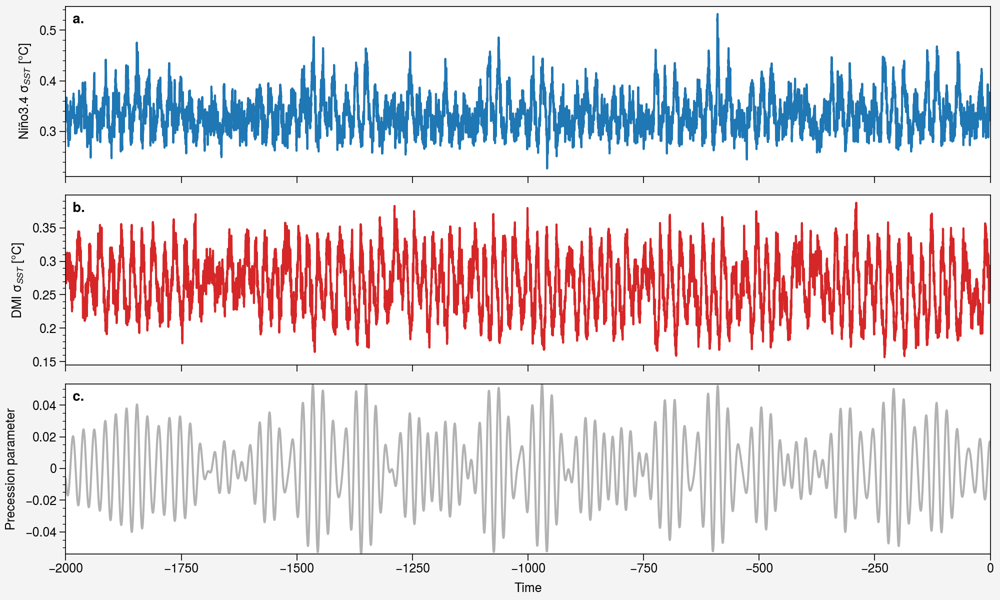

In [21]:
# Running standard deviation of Niño3.4 and DMI with precession parameter

# Time axis from orbital parameter table (years, consistent with df[0])
t = df[0].values
precession = df[5].values

# 200-year running standard deviation sampled as in other parts of the notebook
nino34_std = nino34.rolling(year=200, center=True).std()[::20]
dmi_std    = dmi.rolling(year=200, center=True).std()[::20]

fig, axs = pplt.subplots(nrows=3, ncols=1, figsize=(10,6), sharex=True,sharey=False)

axs[0].plot(df[0], nino34_std, color='tab:blue')
axs[0].set_ylabel('Niño3.4 σ$_{SST}$ [°C]')

axs[1].plot(df[0], dmi_std, color='tab:red')
axs[1].set_ylabel('DMI σ$_{SST}$ [°C]')

# Precession parameter alone (bottom panel)
axs[2].plot(df[0], df[5], c='k', alpha=0.3)
axs[2].set_ylim(precession.min(), precession.max())
axs[2].set_xlim(t.min(), t.max())
axs[2].set_ylabel('Precession parameter')
axs[2].set_xlabel('Time')

axs.format(abc='a.', abcloc='ul', titleloc='c', xtickdir='out', ytickdir='out', grid=False,
xtickminor=False, ygridminor=False, ticklen=4.5, ylabelpad=5, xlabelpad=5)
plt.subplots_adjust(hspace=0.3)
plt.tight_layout()

plt.savefig(f"precession_nino34_dmi.png", dpi=300, format='png',
    bbox_inches='tight', #pad_inches=.3,
    transparent=True
   )    

plt.show()


In [213]:
from svgpathtools import svg2paths
from svgpath2mpl import parse_path

In [214]:
sun_marker = parse_path("""M4671 12787 c-13 -6 -34 -25 -45 -40 l-21 -28 -8 -1457 c-9 -1611
-13 -1503 54 -1538 19 -9 45 -14 63 -11 17 3 181 88 364 190 l332 184 382 7
c275 5 391 11 413 20 39 17 65 56 65 99 0 26 -158 304 -726 1278 -446 764
-739 1257 -760 1277 -36 34 -72 41 -113 19z
M9603 12133 c-32 -19 -2044 -2008 -2075 -2053 -27 -39 -23 -94 10
-130 24 -28 62 -40 397 -136 l370 -106 280 -269 c283 -272 313 -295 367 -282
30 8 64 39 77 71 10 27 38 129 361 1362 89 338 206 785 261 994 120 455 122
462 103 497 -33 64 -92 84 -151 52z
M713 9750 c-62 -38 -78 -88 -45 -147 18 -32 2007 -2044 2052 -2075
39 -27 94 -23 130 10 27 24 41 63 137 398 l106 372 269 278 c271 282 294 312
281 366 -8 30 -39 64 -71 77 -15 6 -189 53 -387 105 -1934 508 -2375 623
-2411 629 -20 4 -41 0 -61 -13z
M6074 9589 c-1027 -99 -1976 -729 -2483 -1645 -183 -330 -311 -723
-366 -1124 -22 -160 -31 -532 -16 -699 63 -715 360 -1378 853 -1907 534 -574
1220 -915 2008 -999 157 -17 488 -19 643 -5 1039 99 1986 723 2496 1646 183
330 311 723 366 1124 22 160 31 532 16 699 -64 721 -364 1386 -865 1921 -528
562 -1215 901 -1996 985 -144 16 -515 18 -656 4z
M9764 8192 c-37 -23 -59 -71 -51 -111 3 -15 89 -177 190 -359 l184
-332 7 -382 c5 -275 11 -391 20 -413 17 -39 56 -65 99 -65 26 0 304 158 1278
726 796 464 1256 738 1278 761 29 31 33 40 28 75 -6 47 -37 84 -81 97 -18 5
-618 12 -1476 15 -1412 7 -1446 6 -1476 -12z
M1309 5544 c-796 -464 -1256 -738 -1278 -761 -29 -31 -33 -40 -28
-75 6 -47 37 -84 81 -97 18 -5 618 -12 1473 -16 1303 -6 1444 -5 1472 10 39
20 65 68 58 109 -3 17 -88 181 -190 364 l-184 332 -7 382 c-5 275 -11 391 -20
413 -17 39 -56 65 -99 65 -26 0 -304 -158 -1278 -726z
M9950 5263 c-27 -25 -40 -63 -136 -399 l-106 -370 -269 -280 c-272
-282 -295 -312 -282 -366 8 -30 39 -64 71 -77 27 -10 129 -38 1362 -361 338
-89 785 -206 994 -261 455 -120 462 -122 497 -103 64 33 84 92 52 151 -19 32
-2008 2044 -2053 2075 -39 27 -94 23 -130 -9z
M3845 3643 c-27 -7 -61 -39 -74 -71 -10 -27 -38 -129 -361 -1362 -89
-338 -206 -785 -261 -994 -120 -455 -122 -462 -103 -497 33 -64 92 -84 151
-51 32 18 2044 2007 2075 2052 27 39 23 94 -9 130 -25 27 -63 40 -399 136
l-371 106 -269 260 c-148 143 -278 266 -289 273 -25 16 -64 24 -90 18z
M8040 3072 c-19 -10 -174 -95 -345 -189 l-310 -171 -380 -7 c-273 -5
-388 -10 -410 -19 -39 -17 -65 -56 -65 -99 0 -26 158 -304 726 -1278 465 -797
738 -1256 761 -1278 31 -29 40 -33 75 -28 47 6 84 37 97 81 5 18 12 618 16
1473 7 1591 11 1484 -55 1518 -38 20 -68 19 -110 -3z""")

sun_marker.vertices -= sun_marker.vertices.mean(axis=0)
sun_marker = sun_marker.transformed(mpl.transforms.Affine2D().rotate_deg(180))
sun_marker = sun_marker.transformed(mpl.transforms.Affine2D().scale(-1,1))

#plt.plot(0,0,marker=sun_marker,markersize=200)

In [215]:
from matplotlib.patches import Ellipse, PathPatch
from matplotlib.path import Path
from scipy.stats import circmean
from scipy.stats import gaussian_kde
from matplotlib.textpath import TextPath
from matplotlib.transforms import Affine2D

In [346]:
cobe_ = xr.open_dataset('variables/sst_cobe.nc').sst
cobe_ = cobe_.sel(time=slice('1950-01-01','2019-12-01'))

In [224]:
# Define row labels
rows = ['WIO', 'EIO', 'DMI', 'Niño3.4', 'Niño3','Niño4']

# Define column labels
columns = [
    'Weighted_angle_95',
    'Weighted_angle_5',
    'Range_high',
    'Range_low'
]

# Create the DataFrame
vals = pd.DataFrame(index=rows, columns=columns)

# Display the DataFrame
print(vals)

        Weighted_angle_95 Weighted_angle_5 Range_high Range_low
WIO                   NaN              NaN        NaN       NaN
EIO                   NaN              NaN        NaN       NaN
DMI                   NaN              NaN        NaN       NaN
Niño3.4               NaN              NaN        NaN       NaN
Niño3                 NaN              NaN        NaN       NaN
Niño4                 NaN              NaN        NaN       NaN


0.6284176
0.24122539
0.32863748
0.3329006
Weighted angle of 95th percentile highest values : 355.71204036430385
Weighted angle of 5th percentile lowest values : 200.7181798449334
Range of highest values: 343.1642495009242 to 10.814971709813216
Range of lowest values: 231.06991867029203 to 169.9990437358723

Weighted angle of 95th percentile highest values : 279.7017211185334
Weighted angle of 5th percentile lowest values : 136.88688561819617
Range of highest values: 301.8674798200036 to 257.20829995006795
Range of lowest values: 160.426133471279 to 113.58620067774321

Weighted angle of 95th percentile highest values : 278.25478696872466
Weighted angle of 5th percentile lowest values : 148.46595643321047
Range of highest values: 298.4564573594531 to 258.3756044325356
Range of lowest values: 173.08051321971007 to 123.09449025489558

Weighted angle of 95th percentile highest values : 104.19315478610214
Weighted angle of 5th percentile lowest values : 291.6934230439464
Range of highest val

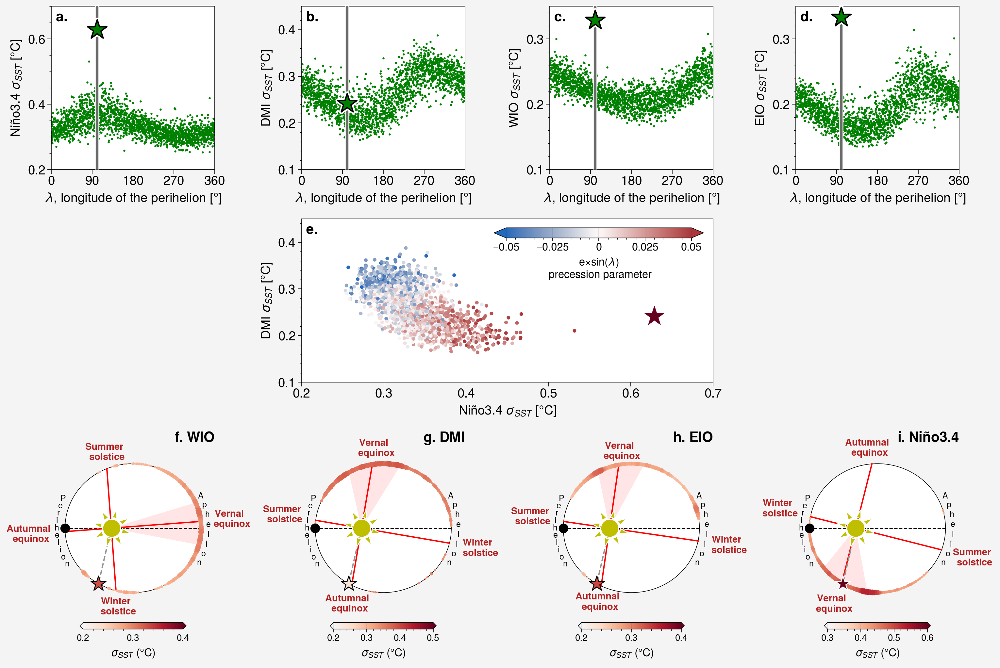

In [ ]:
k = 0

array = [[ 1,  2,  3,  4],
         [ 0,  5,  5,  0],
         [ 6,  7,  8,  9]]
fig, axs = pplt.subplots(array, share=False)

pplt.rc['font.size'] = 14
base_fontsize = pplt.rc['font.size']

s = 3

for ds, name, ax in zip([nino34, dmi, wio, eio], ['nino34', 'dmi', 'wio', 'eio'], axs[0:4]):
    if ds.values[0] == wio.values[0]:
        cobe = cobe_wio.std()
    elif ds.values[0] == dmi.values[0]:
        cobe = cobe_dmi.std()
    elif ds.values[0] == eio.values[0]:
        cobe = cobe_eio.std()
    elif ds.values[0] == nino34.values[0]:
        cobe = cobe_nino34.std()
        
    print(cobe.values)
    
    if name == 'nino34':
        ylabel = 'Niño3.4 $\sigma_{SST}$ [°C]'
        kwargs = {'ylim': (0.2, 0.7), 'ylocator': [0.2, 0.4, 0.6]}
    elif name == 'dmi':
        ylabel = 'DMI $\sigma_{SST}$ [°C]'
        kwargs = {'ylim': (0.1, 0.45), 'ylocator': [0.1, 0.2, 0.3, 0.4]}
    elif name == 'wio':
        ylabel = 'WIO $\sigma_{SST}$ [°C]'
        kwargs = {'ylim': (0.1, 0.35), 'ylocator': [0.1, 0.2, 0.3]}
    elif name == 'eio':
        ylabel = 'EIO $\sigma_{SST}$ [°C]'
        kwargs = {'ylim': (0.1, 0.35), 'ylocator': [0.1, 0.2, 0.3]}

    ax.scatter(df[4][::10][:-1], ds.rolling(year=200, center=True).std()[::200][:-1], c='g', alpha=1, s=s)
    
    ax.format(xlabel=r"$\lambda$, longitude of the perihelion [°]", xlim=(0, 360),
              xlocator=np.arange(0, 360 + 90, 90), ylabel=ylabel, **kwargs)
    
    ax.axvline(abs(280.3 - 180), linestyle='-', color='dimgrey', alpha=1, zorder=10, linewidth=3,
               path_effects=[patheffects.withStroke(linewidth=4.5, foreground="w")])

    ax.scatter(abs(280.3 - 180), cobe, c='g', alpha=1, s=500, marker='*', linewidths=4.75, edgecolors='w', zorder=100)
    ax.scatter(abs(280.3 - 180), cobe, c='g', alpha=1, s=500, marker='*', linewidths=1.5, edgecolors='k', zorder=100)


im = axs[4].scatter(nino34.rolling(year=200, center=True).std()[::200][:-1], dmi.rolling(year=200, center=True).std()[::200][:-1], 
                        c=df[5].values[::10][:-1], 
                        vmin=-0.05,vmax=0.05,
                        #s=abs(df[5].values[::10][:-1]), 
                        #smin=50, smax=50,
                        s=2**3.5,
                        marker="o",
                        cmap="Vlag",colorbar='ur', extend='both',
                        colorbar_kw={'align' : 'center',#'space' : 3, 
                        'length': 15.5, 'width' : .8, 
                        'extend' : 'both', 'ticks': [-0.05, -.025, 0, 0.025, 0.05],
                        'label' :  r"e$\times$sin($\lambda$)" + "\n precession parameter", 'ticklen' : 3.5,
                        'frame' : False, 'labelsize':base_fontsize, 'ticklabelsize':base_fontsize})

axs[4].format(xlabel='Niño3.4 $\sigma_{SST}$ [°C]', ylabel='DMI $\sigma_{SST}$ [°C]', 
              xlocator=[0.2, 0.3, 0.4, 0.5, 0.6, 0.7], ylocator=[0.1, 0.2, 0.3, 0.4], 
              xlim=(0.2, 0.7), ylim=(0.1, 0.45))

axs[4].scatter(cobe_nino34.std(), cobe_dmi.std(), c=abs(280.3 - 180), vmin=-0.05,vmax=0.05, s=500, marker='*')
#axs[4].scatter(dmi.rolling(year=50, center=True).std()[::200][:-1], nino34.rolling(year=50, center=True).std()[::200][:-1], c='g', alpha=1, s=s)

axs[0:5].format(abc='a.', abcloc='ul', titleloc='c', xtickdir='out', ytickdir='out', grid=False,
xtickminor=False, ygridminor=False, ticklen=4.5, ylabelpad=5, xlabelpad=5)

####################################################################

# Loop through different datasets and names
for ax, ds, name in zip( [axs[5], axs[6], axs[7], axs[8]], 
                         [wio, dmi, eio,nino34], #,nino3,nino4], 
                         ['WIO','DMI','EIO','Niño3.4']):#,'Niño3','Niño4']):

    # Parameters of the ellipse
    ra = 4.5
    rp = 0.5

    a = (ra + rp) / 2
    e = (ra - rp) / (ra + rp)
    b = np.sqrt(a ** 2.0 - e ** 2.0)

    x = 3
    y = 3
    angle = 0
    
    p = b ** 2.0 / a
    E = e / a
    
    ax.grid(True)

    ax.add_artist(Ellipse(xy=[x, y], width=2.0 * a, height=2.0 * b, angle=angle, facecolor='w', edgecolor='k'))
    ax.set_xlim(0, 2.0 * x)
    ax.set_ylim(0, 2.0 * y)

    xf = [x - e * np.cos(angle * np.pi / 180.0), x + e * np.cos(angle * np.pi / 180.0)]
    yf = [y - e * np.sin(angle * np.pi / 180.0), y + e * np.sin(angle * np.pi / 180.0)]

    ax.plot(xf[0], yf[0], '-y', marker=sun_marker, markeredgecolor='w', markeredgewidth=1, markersize=40, zorder=150)

    angles = [0, 180]

    for t_angle in angles:
        xrp, yrp = rays(t_angle, e, a, b)
        ax.plot([xf[0], xf[0] + xrp], [yf[0], yf[0] + yrp], '--k', linewidth=1)
        if t_angle == 180:
            ax.scatter([xf[0] + xrp], [yf[0] + yrp], color='k', marker='o', s=100, zorder=185)

            label_text = "Perihelion"[::-1]
            add_curved_text_outside(ax, label_text, 9, 8, xf[0] - .05 , yf[0], a, b, e, t_angle - 40)
        elif t_angle == 0:
            label_text = "Aphelion"
            add_curved_text_outside(ax, label_text, 9, 6, xf[0] + .05, yf[0], a, b, e, t_angle - 20)

    x = xf[0] + rays(df[4], a=a, b=b, e=e)[0]
    y = yf[0] + rays(df[4], a=a, b=b, e=e)[1]
    z = ds.rolling(year=200, center=True).std()[::20]

    cond_max = (z >= np.nanpercentile(z,95)) #(z <= np.nanpercentile(z,5)) | (z >= np.nanpercentile(z,95))
    idx_max = np.where(cond_max) #z.where(cond).argsort()
    x_max, y_max, z_max = x.values[idx_max], y.values[idx_max], z.values[idx_max]
    
    idx_max = np.argsort(z_max)
    x_max, y_max, z_max = x_max[idx_max], y_max[idx_max], z_max[idx_max]
    
    cond_min = (z <= np.nanpercentile(z,5)) #(z <= np.nanpercentile(z,5)) | (z >= np.nanpercentile(z,95))
    idx_min = np.where(cond_min) #z.where(cond).argsort()
    x_min, y_min, z_min = x.values[idx_min], y.values[idx_min], z.values[idx_min]
    
    idx_min = np.argsort(-z_min)
    x_min, y_min, z_min = x_min[idx_min], y_min[idx_min], z_min[idx_min]
    
    # Get the RdBu colormap
    cmap = plt.get_cmap('RdBu_r')
    # Define the range you want to use (e.g., from 0.3 to 0.7)
    start = 0.5
    end = 1
    # Create a new colormap using the subset of the original colormap
    cmap = LinearSegmentedColormap.from_list(
        'new_RdBu', 
        cmap(np.linspace(start, end, 256))
    )

    step = 0.1


    if (ds[0] == wio[0]) or (ds[0] == eio[0]) :
        # step=.05
        vmin,vmax=.2,.4
        levels = np.arange(vmin, vmax+step, step)#[::2]
    elif (ds[0] == dmi[0]):
        vmin,vmax=.2,.5
        levels = np.arange(vmin, vmax+step, step)
    else:
        vmin,vmax=.3,.6
        levels = np.arange(vmin, vmax+step, step)
       
    im = ax.scatter(x_max, y_max, c=z_max, s=10**z_max + 50, cmap=cmap, vmin=vmin, vmax=vmax, zorder=150)

    percentile_95 = np.nanpercentile(ds.rolling(year=200, center=True).std()[::20], 95)
    
    high_std_indices = np.where(ds.rolling(year=200, center=True).std()[::20] >= percentile_95)[0]
    high_std_values = df[4].iloc[high_std_indices]

    high_std_variability = ds.rolling(year=200, center=True).std()[::20].values[high_std_indices]

    weighted_angle_95 = weighted_angle(high_std_values,high_std_variability)

    percentile_5 = np.nanpercentile(ds.rolling(year=200, center=True).std()[::20], 5)
    
    low_std_indices = np.where(ds.rolling(year=200, center=True).std()[::20] <= percentile_5)[0]
    low_std_values = df[4].iloc[low_std_indices]

    low_std_variability = ds.rolling(year=200, center=True).std()[::20].values[low_std_indices]
    
    weighted_angle_5 = weighted_angle(low_std_values,low_std_variability)

    # Print the range of high standard deviation values
    #print(f"Range of 95th percentile highest values: {high_std_values.min()} to {high_std_values.max()}")
    print(f"Weighted angle of 95th percentile highest values : {weighted_angle_95}")

    vals.loc[name, 'Weighted_angle_95'] = f"{weighted_angle_95:.1f}"

    # Print the range of low standard deviation values
    #print(f"Range of 5th percentile lowest values: {low_std_values.min()} to {low_std_values.max()}")
    print(f"Weighted angle of 5th percentile lowest values : {weighted_angle_5}")

    vals.loc[name, 'Weighted_angle_5'] = f"{weighted_angle_5:.1f}"

    #%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%% HIGH
    
    # Calculate the 10th and 90th percentiles of high_std_values
    median = np.percentile(high_std_values, 50) #50th percentile = median
    #percentile_up = np.percentile(high_std_values, 50) #50th percentile = median

    # Find the values in high_std_values within the 10th and 90th percentiles
    high_std_values_dwn = high_std_values[high_std_values >= median]
    high_std_values_up = high_std_values[high_std_values <= median]
    
    high_var_dwn = high_std_variability[high_std_values >= median]
    high_var_up = high_std_variability[high_std_values <= median]
    
    mean_min_angle = weighted_angle(high_std_values_dwn, high_var_dwn)
    mean_max_angle = weighted_angle(high_std_values_up, high_var_up)
    
    #weighted_angle_max[name] = [weighted_angle_95,mean_min_angle,mean_max_angle]
    
    print(f"Range of highest values: {mean_min_angle} to {mean_max_angle}")

    vals.loc[name, 'Range_high'] = np.array([float(f"{min(mean_min_angle,mean_max_angle):.1f}"),float(f"{max(mean_min_angle,mean_max_angle):.1f}")])
    
    plot_hatching_pattern(ax, xf, yf, e, a, b, mean_min_angle, mean_max_angle,'r')

    # Calculate the corresponding rays
    xrp_mean_min, yrp_mean_min = rays(mean_min_angle, e, a, b)
    xrp_mean_max, yrp_mean_max = rays(mean_max_angle, e, a, b)

    #%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%%% LOW
    
    # Calculate the 10th and 90th percentiles of low_std_values
    median = np.percentile(low_std_values, 50) #50th percentile = median
    #percentile_up = np.percentile(low_std_values, 50) #50th percentile = median

    # Find the values in high_std_values within the 10th and 90th percentiles
    low_std_values_dwn = low_std_values[low_std_values >= median]
    low_std_values_up = low_std_values[low_std_values <= median]
    
    low_var_dwn = low_std_variability[low_std_values >= median]
    low_var_up = low_std_variability[low_std_values <= median]
    
    mean_min_angle = weighted_angle(low_std_values_dwn, low_var_dwn)
    mean_max_angle = weighted_angle(low_std_values_up, low_var_up)
    
    #weighted_angle_min[name] = [weighted_angle_5,mean_min_angle,mean_max_angle]
    
    print(f"Range of lowest values: {mean_min_angle} to {mean_max_angle}")

    vals.loc[name, 'Range_low'] = np.array([float(f"{min(mean_min_angle,mean_max_angle):.1f}"),float(f"{max(mean_min_angle,mean_max_angle):.1f}")])
    
    #plot_hatching_pattern(ax, xf, yf, e, a, b, mean_min_angle, mean_max_angle,'b')

    # Calculate the corresponding rays
    xrp_mean_min, yrp_mean_min = rays(mean_min_angle, e, a, b)
    xrp_mean_max, yrp_mean_max = rays(mean_max_angle, e, a, b)

    for LOP,c in zip([weighted_angle_95, #weighted_angle_5
    ],
                     ['r',# 'b'
                     ]):
        
        #print(LOP)

        angles_LOP = [LOP,LOP+90,LOP+180,LOP+270]
        
        #print(angles_LOP)

        ax.plot([xf[0], xf[0]+rays(LOP,a=a,b=b,e=e)[0]],[yf[0], yf[0]+rays(LOP,a=a,b=b,e=e)[1]],'-',color=c, \
                 zorder=100)
        ax.plot([xf[0], xf[0]+rays(LOP+90,a=a,b=b,e=e)[0]],[yf[0], yf[0]+rays(LOP+90,a=a,b=b,e=e)[1]],'-',color=c, \
                 zorder=100)
        ax.plot([xf[0], xf[0]+rays(LOP+180,a=a,b=b,e=e)[0]],[yf[0], yf[0]+rays(LOP+180,a=a,b=b,e=e)[1]],'-',color=c, \
                 zorder=100)
        ax.plot([xf[0], xf[0]+rays(LOP+270,a=a,b=b,e=e)[0]],[yf[0], yf[0]+rays(LOP+270,a=a,b=b,e=e)[1]],'-',color=c, \
                 zorder=100)

        #ax.plot([xf[0], xf[0]+rays(LOP,a=a,b=b,e=e)[0]][-1],[yf[0], yf[0]+rays(LOP,a=a,b=b,e=e)[1]][-1],'-r', \
        #        marker=earth_marker, markersize=50, zorder=100)

        # Putting labels closer to the rays:

        if LOP == weighted_angle_95:
            if ds.values[0] == nino34.values[0]:
                offsets = [.9, 1.2, .7, 1.2] # vernal, winter, autumn, summer
            elif (ds.values[0] == dmi.values[0]):
                offsets = [.6, 1.1, .7, 1.2] # vernal, winter, autumn, summer
            elif (ds.values[0] == eio.values[0]):
                offsets = [.5, 1.1, .6, 1.2] # vernal, winter, autumn, summer
            elif ds.values[0] == wio.values[0]:
                offsets = [1.1, .6, 1.3, .6] # vernal, winter, autumn, summer
            else:
                'Hell no!'
        else:
            
            if ds.values[0] == nino34.values[0]:
                offsets = [.6, .7, .6, .7]
            elif (ds.values[0] == dmi.values[0]): 
                offsets = [.7, .6, .6, .6]
            elif (ds.values[0] == eio.values[0]):
                offsets = [.7, .6, .6, .5]
            elif ds.values[0] == wio.values[0]:
                offsets = [.9, .5, .9, .5]
            else:
                'Hell no!'

        rLabel = [p / (1 - E * np.cos(t * np.pi / 180)) + offset for t,offset in zip(angles_LOP,offsets)]
        xrl = [r * np.cos(t * np.pi / 180) for r, t in zip(rLabel, angles_LOP)]
        yrl = [r * np.sin(t * np.pi / 180) for r, t in zip(rLabel, angles_LOP)]

        xrpl = [xi * np.cos(angle * np.pi / 180.0) - yi * np.sin(angle * np.pi / 180.0) for xi, yi in zip(xrl, yrl)]
        yrpl = [xi * np.sin(angle * np.pi / 180.0) + yi * np.cos(angle * np.pi / 180.0) for xi, yi in zip(xrl, yrl)]

        # Convert the angle t from radians into degrees:
        tl = ['Vernal \n equinox','Winter \n solstice','Autumnal \n equinox','Summer \n solstice']

        for q in range(0, len(tl)):
            rotate_label = angle
            label_text = f'{tl[q]}'
            if name == "Niño3.4":
                if LOP == weighted_angle_95:
                    if label_text == 'Autumnal \n equinox':
                        ax.text(xf[0] + xrpl[q] - .3, yf[0] + yrpl[q] + .1, label_text, va='center', \
                        ha='center', rotation=rotate_label, fontsize=10.5,color='firebrick', fontweight='bold')
                    elif label_text == 'Vernal \n equinox':
                        ax.text(xf[0] + xrpl[q] -.1, yf[0] + yrpl[q] - .1, label_text, va='center', \
                        ha='center', rotation=rotate_label, fontsize=10.5,color='firebrick', fontweight='bold')
                    else:
                        ax.text(xf[0] + xrpl[q], yf[0] + yrpl[q], label_text, va='center', \
                        ha='center', rotation=rotate_label, fontsize=10.5,color='firebrick', fontweight='bold')    
                else:
                    if label_text == 'Autumnal \n equinox':
                        ax.text(xf[0] + xrpl[q] - .3, yf[0] + yrpl[q] - .2, label_text, va='center', \
                        ha='center', rotation=rotate_label, fontsize=10.5,color='firebrick', fontweight='bold')
                    elif label_text == 'Vernal \n equinox':
                        ax.text(xf[0] + xrpl[q] + .2, yf[0] + yrpl[q] + .1, label_text, va='center', \
                        ha='center', rotation=rotate_label, fontsize=10.5,color='firebrick', fontweight='bold')
                    else:
                        ax.text(xf[0] + xrpl[q], yf[0] + yrpl[q], label_text, va='center', \
                        ha='center', rotation=rotate_label, fontsize=10.5,color='firebrick', fontweight='bold')  
            else:
                ax.text(xf[0] + xrpl[q], yf[0] + yrpl[q], label_text, va='center', \
                    ha='center', rotation=rotate_label, fontsize=10.5,color='firebrick', fontweight='bold')
            
    
    ax.plot([xf[0], xf[0]+rays(103,a=a,b=b,e=e)[0]],[yf[0], yf[0]+rays(103,a=a,b=b,e=e)[1]],'--',color='gray', \
                 zorder=100)
    
    cobe_nino34_ = cobe_.sel(lat=slice(5,-5),lon=slice(360-170,360-120)).mean(dim=('lat','lon')).groupby('time.year').mean().std()#.rolling(year=10).std().mean()

    cobe_eio_ = cobe_.sel(lat=slice(0,-10),lon=slice(90,110)).mean(dim=('lat','lon')).groupby('time.year').mean().std()#.rolling(year=10).std().mean()

    cobe_wio_ = cobe_.sel(lat=slice(10,-10),lon=slice(50,70)).mean(dim=('lat','lon')).groupby('time.year').mean().std()#.rolling(year=10).std().mean()

    cobe_dmi_ = (cobe_.sel(lat=slice(10,-10),lon=slice(50,70)).mean(dim=('lat','lon')).groupby('time.year').mean() - cobe_.sel(lat=slice(0,-10),lon=slice(90,110)).mean(dim=('lat','lon')).groupby('time.year').mean()).std()
    
    if (ds[0] == wio[0]) or (ds[0] == eio[0]) or (ds[0] == dmi[0]):
        #step = 0.05
        if ds.values[0] == wio.values[0]:
            ax.scatter(xf[0]+rays(103,a=a,b=b,e=e)[0], yf[0]+rays(103,a=a,b=b,e=e)[1], \
                c=cobe_wio_, s=10**cobe_wio_ + 300, marker='*',linewidths=1, edgecolors='k',cmap=cmap, vmin=vmin, vmax=vmax, zorder=180)
        elif (ds.values[0] == dmi.values[0]):
            ax.scatter(xf[0]+rays(103,a=a,b=b,e=e)[0], yf[0]+rays(103,a=a,b=b,e=e)[1], \
                c=cobe_dmi_, s=10**cobe_dmi_ + 300, marker='*',linewidths=1, edgecolors='k',cmap=cmap, vmin=vmin, vmax=vmax, zorder=180)
        elif (ds.values[0] == eio.values[0]):
            ax.scatter(xf[0]+rays(103,a=a,b=b,e=e)[0], yf[0]+rays(103,a=a,b=b,e=e)[1], \
                c=cobe_eio_, s=10**cobe_eio_ + 300, marker='*',linewidths=1, edgecolors='k',cmap=cmap, vmin=vmin, vmax=vmax, zorder=180)
    else:
        #step = 0.1
        ax.scatter(xf[0]+rays(103,a=a,b=b,e=e)[0], yf[0]+rays(103,a=a,b=b,e=e)[1], \
                c=cobe_nino34_, s=10**cobe_nino34_ + 300, marker='*',linewidths=1, edgecolors='w',cmap=cmap, vmin=vmin, vmax=vmax, zorder=180)
        
    
    cbar = ax.colorbar(im, loc='b', extend ='both', ticklen = 3.75, 
    length=.65, width=0.1, align='center', space=1, extendsize=0.25)
    cbar.set_label(r"$\sigma_{SST}$ (°C)", fontsize=base_fontsize, labelpad=5)
    cbar.ax.tick_params(labelsize=base_fontsize)
    cbar.set_ticks(levels)

    ax.invert_yaxis()

    ax.axis('off')

    ax.format(abc='a.', abcloc='r', titleloc='r', title=name, titleweight='bold')
    
    k += 1 
    
    print('')

    #break

plt.savefig(f"orbit/all.png", dpi=300, format='png',
        bbox_inches='tight', pad_inches=.3,
        transparent=True
       )

plt.show()

In [377]:
vals

,Weighted_angle_95,Weighted_angle_5,Range_high,Range_low
WIO,355.7,200.7,"[10.8, 343.2]","[170.0, 231.1]"
EIO,278.3,148.5,"[258.4, 298.5]","[123.1, 173.1]"
DMI,279.7,136.9,"[257.2, 301.9]","[113.6, 160.4]"
Niño3.4,104.2,291.7,"[79.7, 129.0]","[257.1, 317.3]"
Niño3,114.9,275.3,"[91.6, 138.9]","[240.9, 303.0]"
Niño4,352.4,159.9,"[19.8, 328.8]","[134.0, 185.2]"


In [ ]:
#vals.to_csv('variables/vals.csv',index=True)
vals.to_pickle('variables/vals_new.pkl')